In [17]:
""" Define a redness index on copepod microscope images

Usage:
======
    1. Read, segment and avoid artefacts
    - Read all raw copepod color images from a folder [x]
    - Zoom and/or avoid dark parts from the microscope or part of the petri box [ ]
    - Separate the copepod from the background [x]
    - Save modified images [ ] and array of background definition [x]
    
    2. Intercalibrate RGB channels
     - Read segmented and clean images and associate background file [x]
     - Intercalibrate them from the backround RGB values [x]
     - Save calibrated images [ ]
     
    3. Quantify redness
    - Identify red pixels [x]
    - Quantify % of red pigments on the segmented copepod [ ]
    - Quantify total redness (normalisation by pixel size and/or prosome lenght)[ ]
     
"""

__authors__ = ("Laure Vilgrain", "Jean-Olivier Irisson")
__contact__ = ("laure.vilgrain@imev-mer.fr", "irisson@normalesup.org")
__version__ = "1.0.0"
__date__ = "04-2021"

In [6]:
import pandas as pd
import numpy as np
import xarray as xr
import os
from matplotlib import pyplot as plt
from skimage import io, data, color, exposure, feature, morphology, measure
from scipy import ndimage as ndi
import copy

from skimage.io import imread
from skimage.color import separate_stains
from scipy import linalg
from skimage.filters import threshold_otsu

In [7]:
### 1. Read, segment and avoid artefacts

In [8]:
## 1.1. Read images and remove black parts and other artefacts

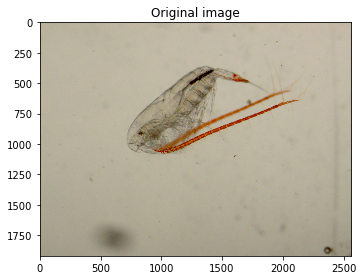

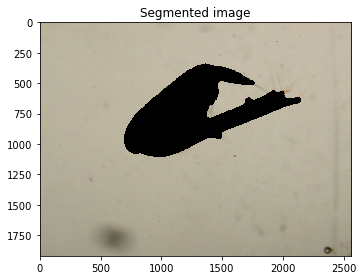

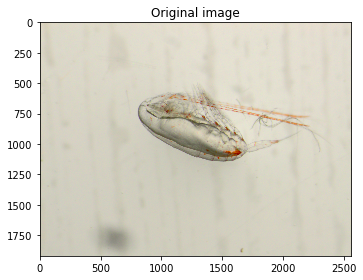

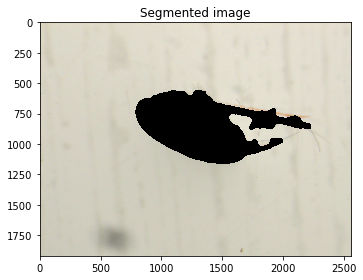

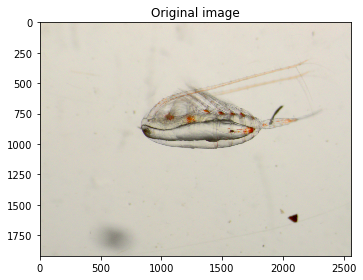

...

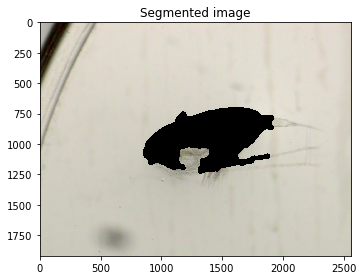

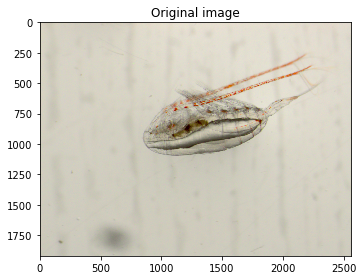

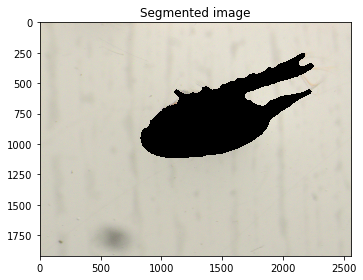

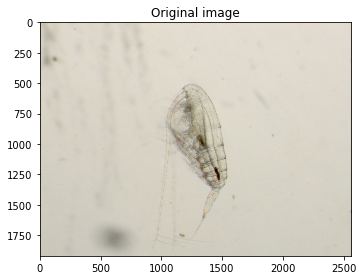

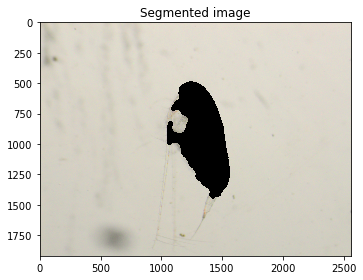

Original average intensities in RGB for the background in all images are [170.84065579812355, 206.6041591655925, 206.50139224402145, 204.37314612519165, 176.77533545592306, 203.7894738392401, 178.11895860415981, 181.27661993113816, 203.49597461332087, 170.40511264895656, 171.28938842960792, 181.79588650972286, 175.28506006966626, 175.14451711977105, 204.1448086812375, 181.44821121438827, 204.34171036619512, 201.46717150556753, 203.95064310492668, 207.03308524066904] -> this list will be saved to use the mean in images calibration
An array containing background definition by image is saved


In [9]:
## 1.2. Separate copepod from the background

ims_back = []
avr_back_list = []

for image in os.listdir("image_data/Emilia_images/2019/Bellsund/B_Astaxa")[0:20]:
    filename = "image_data/Emilia_images/2019/Bellsund/B_Astaxa/"+image
    im = io.imread(filename) # read image file
    if image in os.listdir("image_data/Emilia_images/2019/Bellsund/B_Astaxa")[0:20] :
        plt.title("Original image")
        io.imshow(filename)
        plt.show()
        io.imsave("image_data/processed_images/first_try/" + image + "_original.jpg", im)
    
    # 1. Segment regions of the image
    im_grey = color.rgb2gray(im) # transform in black and white
    im_eq = exposure.rescale_intensity(im_grey) # enhance contrast
    im_edges = feature.canny(im_eq, sigma=2) # find edges
    im_dilat = morphology.binary_dilation(im_edges, morphology.disk(20)) #grow edges
    im_close = morphology.binary_closing(im_dilat, morphology.disk(30)) # fill small regions
    im_fill = ndi.morphology.binary_fill_holes(im_close) # fill larger holes
    #io.imshow(im_fill)
    #plt.show()
    im_label = measure.label(im_fill) #label each region of the image
    #io.imshow(im_label)
    #plt.show()
    
    # 2. Get largest object and define the background
    props = measure.regionprops(im_label) # measure properties of all objects
    #props0 contains the foreground object with label=1
    areas = [p.area for p in props] # get they areas 
    i_max = np.argmax(areas) 
    #print("Here are the areas of the different regions labelled on the image : ", areas)
    back = (im_label != props[i_max].label)
    ims_back.append(back)
    # NB: label = 0 is the background in the labelled image,
    #     so object 0 is label = 1, object 1 is label = 2 etc.
    im_blanked = copy.copy(im)
    im_blanked[~back,:] = 0 # what does it mean ? replace all values that correspond to the largest object by 0 (for wich back is FALSE)
    # print(im_blanked[:3])
    if image in os.listdir("image_data/Emilia_images/2019/Bellsund/B_Astaxa")[0:20] :
        plt.title("Segmented image")
        io.imshow(im_blanked)
        plt.show()
        io.imsave("image_data/processed_images/second_try/" + image + "_segmented.jpg", im_blanked)

    
    # 3. Compute average intensity of the background only (so the copepod does not influence the following calibration)
    avg = np.mean(im[back,:])
    avr_back_list.append(avg)

print("Original average intensities in RGB for the background in all images are", avr_back_list, "-> this list will be saved to use the mean in images calibration")
print("An array containing background definition by image is saved")

#TODO : save the tow lists in data folder to have a modular code


In [10]:
## 1.3. Save modified images and array of background definition

In [11]:
### 2. Intercalibrate RGB channels

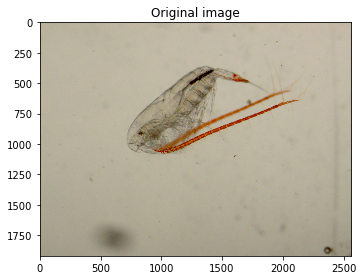

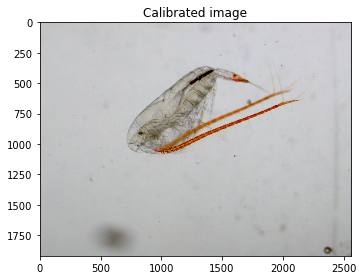

The orginal color intensities in R,G,B for the entire image are : [179.73985738 171.32431641 150.53726746]
The new color intensities in R,G,B for the entire image are : [189.18817464 188.67289836 188.04124288]
---


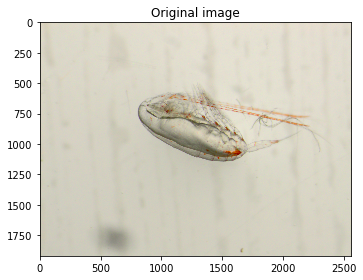

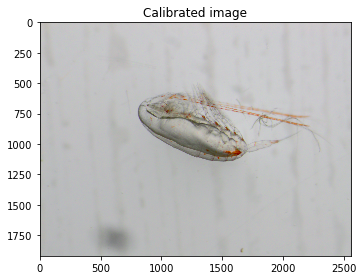

The orginal color intensities in R,G,B for the entire image are : [210.97920308 206.83383789 190.55346069]
The new color intensities in R,G,B for the entire image are : [188.02982056 187.92368205 187.60366516]
---


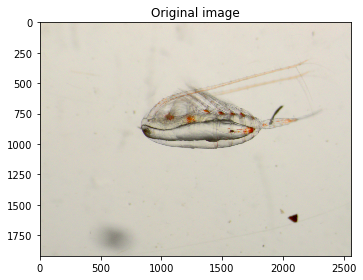

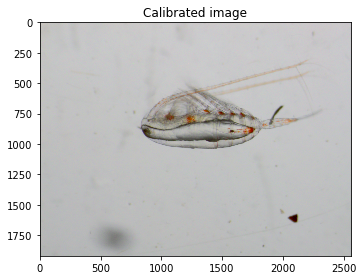

The orginal color intensities in R,G,B for the entire image are : [210.35176086 205.3566097  191.82490662]
The new color intensities in R,G,B for the entire image are : [188.52561401 188.40152303 187.94712626]
---


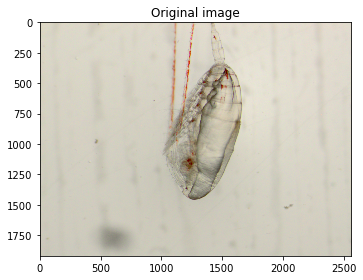

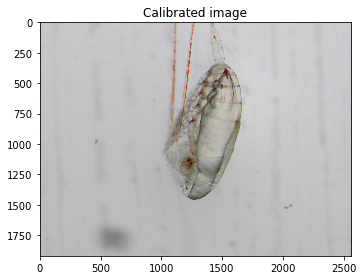

The orginal color intensities in R,G,B for the entire image are : [207.2881425  202.61241536 187.78233175]
The new color intensities in R,G,B for the entire image are : [187.74359619 187.54767598 186.78248291]
---


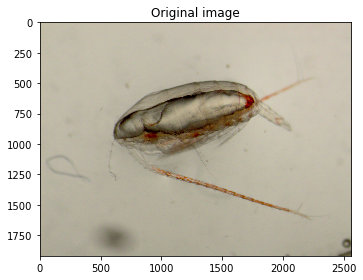

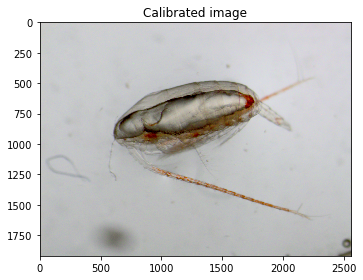

The orginal color intensities in R,G,B for the entire image are : [180.63431234 173.51278951 154.83282328]
The new color intensities in R,G,B for the entire image are : [187.47906698 187.01830404 186.32219747]
---


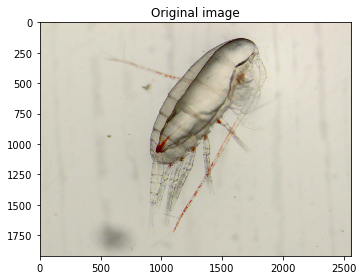

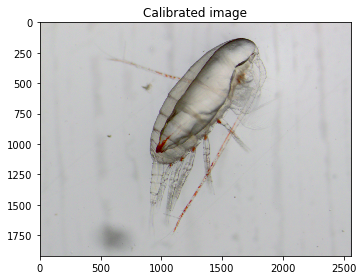

The orginal color intensities in R,G,B for the entire image are : [203.93485921 199.31759908 184.52965698]
The new color intensities in R,G,B for the entire image are : [187.93578064 187.69456706 187.34733378]
---


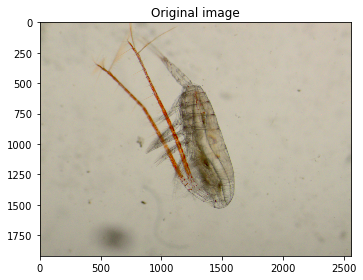

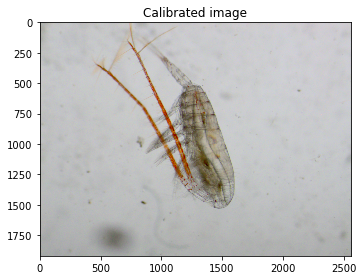

The orginal color intensities in R,G,B for the entire image are : [184.15727559 176.57374756 157.16505493]
The new color intensities in R,G,B for the entire image are : [187.05492533 186.52959819 185.3726414 ]
---


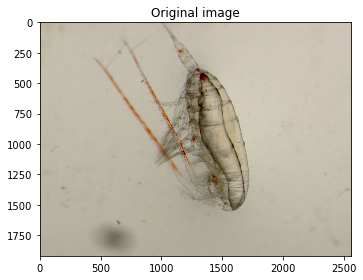

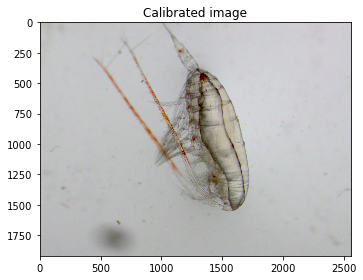

The orginal color intensities in R,G,B for the entire image are : [185.51064677 178.77046387 160.41220581]
The new color intensities in R,G,B for the entire image are : [186.49385234 186.25880981 185.51740519]
---


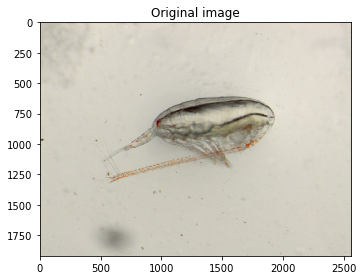

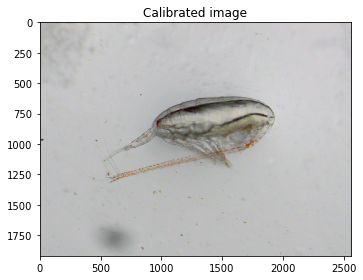

The orginal color intensities in R,G,B for the entire image are : [204.81234456 200.77156901 188.01057231]
The new color intensities in R,G,B for the entire image are : [187.53710815 187.38967    187.01060079]
---


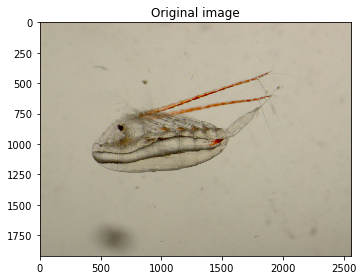

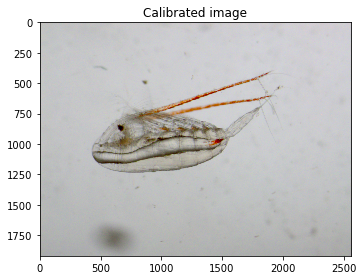

The orginal color intensities in R,G,B for the entire image are : [178.18774007 170.30210185 149.63373576]
The new color intensities in R,G,B for the entire image are : [189.20609029 188.76747579 188.27249329]
---


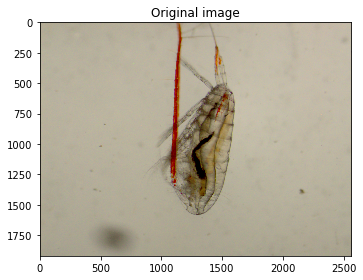

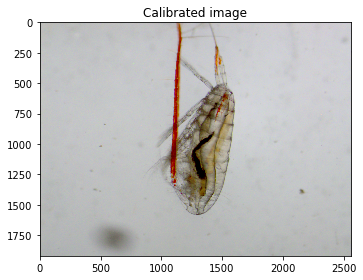

The orginal color intensities in R,G,B for the entire image are : [177.21716756 168.73143921 148.01535156]
The new color intensities in R,G,B for the entire image are : [186.93977234 186.3052006  185.20986003]
---


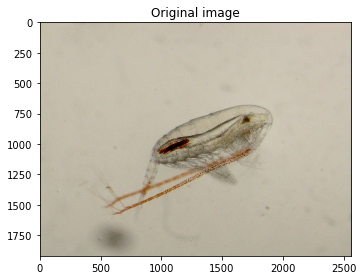

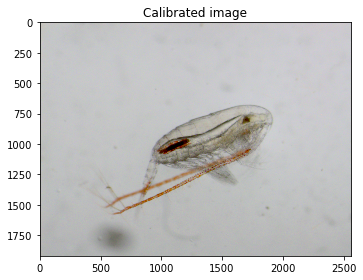

The orginal color intensities in R,G,B for the entire image are : [188.4125116  181.60644877 162.88972168]
The new color intensities in R,G,B for the entire image are : [188.4125116  188.22721008 187.78439128]
---


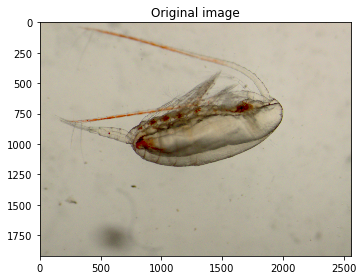

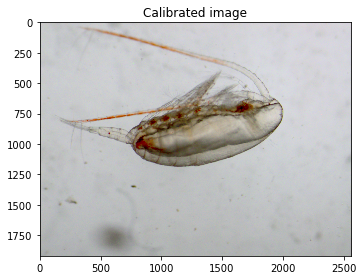

The orginal color intensities in R,G,B for the entire image are : [179.00697123 171.29010091 151.7885439 ]
The new color intensities in R,G,B for the entire image are : [187.72921631 187.30722555 186.49657796]
---


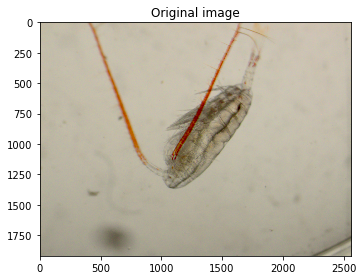

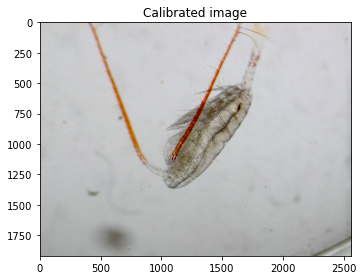

The orginal color intensities in R,G,B for the entire image are : [182.8023055  174.87398519 155.58730428]
The new color intensities in R,G,B for the entire image are : [188.2944755  187.75994466 187.21770976]
---


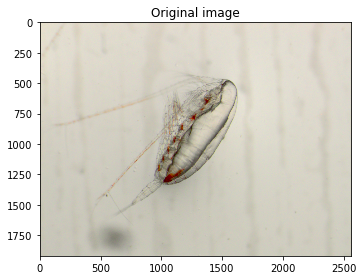

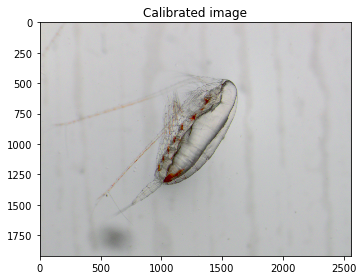

The orginal color intensities in R,G,B for the entire image are : [207.17170776 202.98803141 189.29513611]
The new color intensities in R,G,B for the entire image are : [188.27055501 188.15045939 187.9225057 ]
---


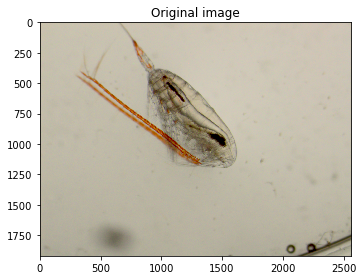

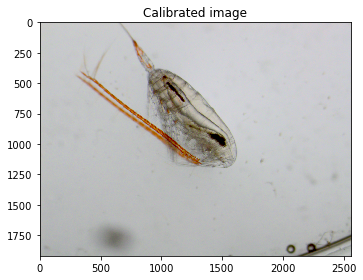

The orginal color intensities in R,G,B for the entire image are : [187.41856791 180.11754211 161.3715387 ]
The new color intensities in R,G,B for the entire image are : [187.45215291 187.40575134 186.75700846]
---


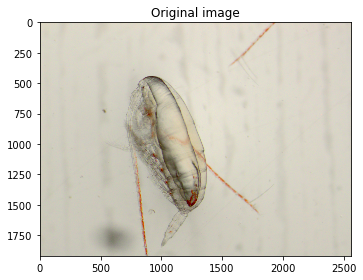

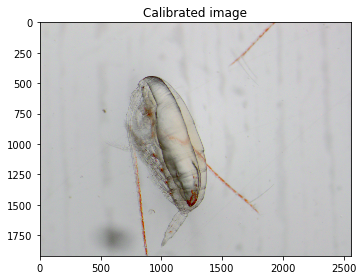

The orginal color intensities in R,G,B for the entire image are : [206.30816732 201.62419434 186.68625122]
The new color intensities in R,G,B for the entire image are : [190.28530945 190.14217814 189.61853699]
---


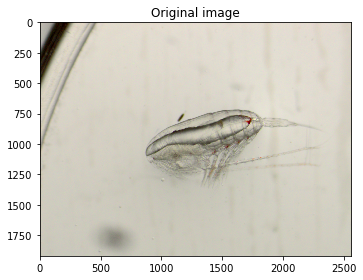

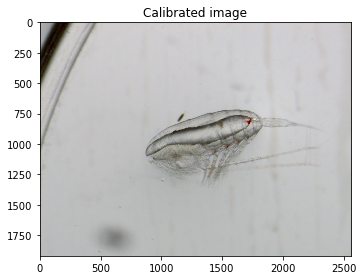

The orginal color intensities in R,G,B for the entire image are : [205.28055664 201.08646566 187.83591105]
The new color intensities in R,G,B for the entire image are : [188.20881531 188.20147339 187.83591105]
---


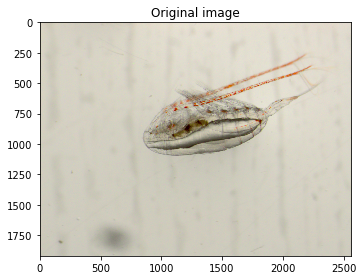

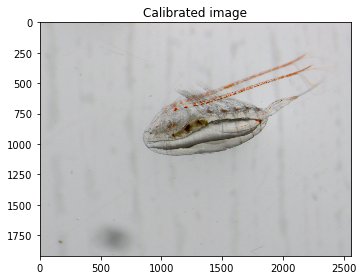

The orginal color intensities in R,G,B for the entire image are : [207.04581034 202.42966512 187.48313517]
The new color intensities in R,G,B for the entire image are : [187.85418376 187.62526957 187.48313517]
---


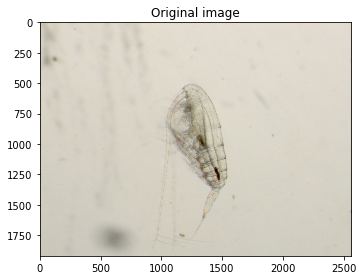

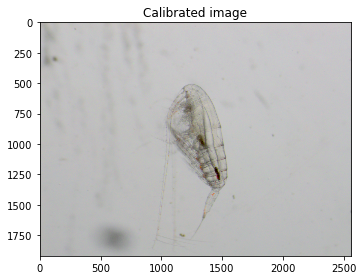

The orginal color intensities in R,G,B for the entire image are : [212.32622925 207.75585347 194.42601766]
The new color intensities in R,G,B for the entire image are : [188.14935404 187.92844238 187.54469971]
---
Mean RGB value among images is 187.66892100016278 and standard deviation is 0.9870038150436454
Calibrated images are stored in a list


In [12]:
## 2.1. Calibrate image color based on mean average RGB intensity of all images considered

ims_calib = [] #list with calibrated images
final_RGB = [] #list with final

for image in os.listdir("image_data/Emilia_images/2019/Bellsund/B_Astaxa")[0:20]:
    filename = "image_data/Emilia_images/2019/Bellsund/B_Astaxa/"+image
    im = io.imread(filename) # read image file
    if image in os.listdir("image_data/Emilia_images/2019/Bellsund/B_Astaxa")[0:20] :
        plt.title("Original image")
        io.imshow(filename)
        plt.show()
    
    # compute average intensity per channel for the background
    avg_r = np.mean(im[back,0])
    avg_g = np.mean(im[back,1])
    avg_b = np.mean(im[back,2])
    
    # convert all channels to have similar average intensities on the orginal image
    im_calib = copy.copy(im)
    im_calib[:,:,0] = np.minimum(im[:,:,0] / avg_r * np.mean(avr_back_list), 255)
    im_calib[:,:,1] = np.minimum(im[:,:,1] / avg_g * np.mean(avr_back_list), 255)
    im_calib[:,:,2] = np.minimum(im[:,:,2] / avg_b * np.mean(avr_back_list), 255)
    # NB: check that this stays in [0,255] = [black, white]
    ims_calib.append([image, im_calib])
    
    # and verify the result
    # all values are supposed to be equal (or very close)
    if image in os.listdir("image_data/Emilia_images/2019/Bellsund/B_Astaxa")[0:20] :
        plt.title("Calibrated image")
        io.imshow(im_calib)
        plt.show()
        io.imsave("image_data/processed_images/second_try/" + image + "_calibrated.jpg", im_calib)
        print("The orginal color intensities in R,G,B for the entire image are :", np.mean(im, axis=(0,1)))
        print("The new color intensities in R,G,B for the entire image are :", np.mean(im_calib, axis=(0,1)))
        print("---")
    final_RGB.append(np.mean(im_calib, axis=(0,1)))# stock the RGB calibrated values in a list

print("Mean RGB value among images is", np.mean(final_RGB), "and standard deviation is", np.std(final_RGB))
print("Calibrated images are stored in a list")

# TODO : plot the distribution of RGB values to see if there are outliers

In [13]:
## 2.2. TODO : maybe store calibrated images in a new folder

In [14]:
### 3. Redness quantification

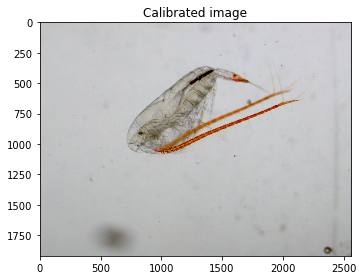

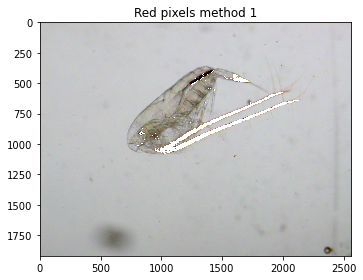

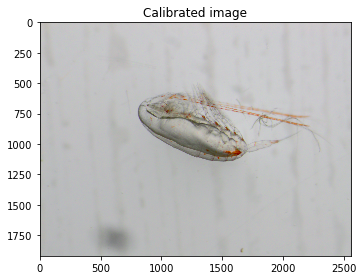

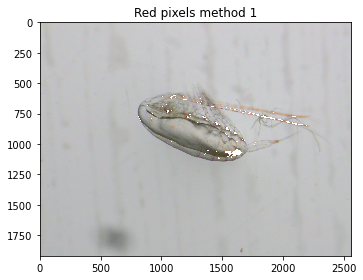

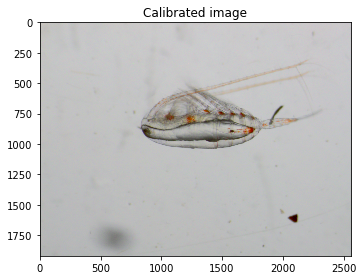

...

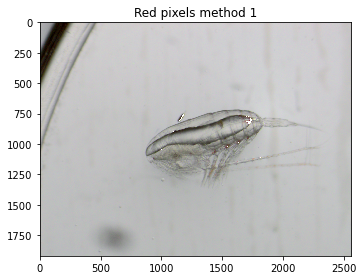

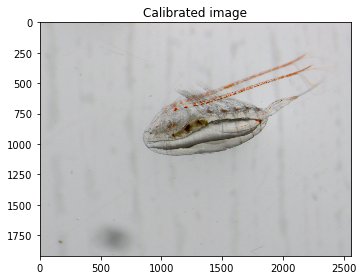

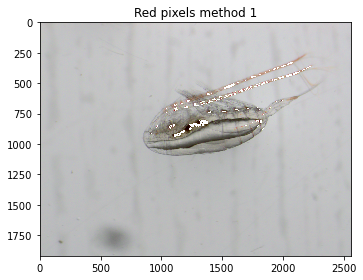

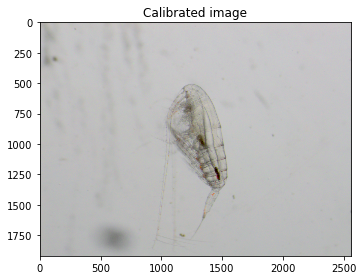

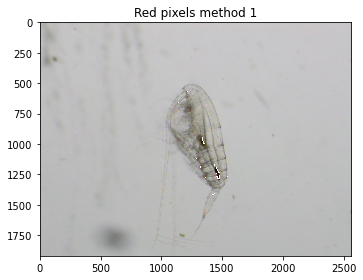

In [15]:
## 3.1. Identify red pigments (method 1 - LHC color space) 

for i in range(len(ims_calib)) :
    
    # Convert in LHC color space
    if i in range(0,20) :
        plt.title("Calibrated image")
        io.imshow(ims_calib[i][1])
        plt.show()
    
    im_lch = color.lab2lch(color.rgb2lab(ims_calib[i][1]))
    
    # Segment the red portions

    # get the reds based on hue (in [0,360]), color intensity, lightness
    # and the copepod mask
    # reference for hue in degrees https://en.wikipedia.org/wiki/Hue
    
    hues = im_lch[:,:,2] / 2 * np.pi * 360 #hues in degrees
    reds = ((hues < 60) | (hues > 300)) & \
           (im_lch[:,:,1] > 27) & \
           ((im_lch[:,:,0] > 10) & (im_lch[:,:,0] < 89)) & \
           ~ims_back[i]

    
    # Show on original image
    im_highlight = copy.copy(ims_calib[i][1])
    im_highlight[:,:,0][reds] = 255
    im_highlight[:,:,1][reds] = 255
    im_highlight[:,:,2][reds] = 255
    
    if i in range(0,20) :
        plt.title("Red pixels method 1")
        io.imshow(im_highlight)
        plt.show()
        io.imsave("image_data/processed_images/second_try/" + ims_calib[i][0] + "_redpixels_LHCmethod.jpg", im_highlight)

# Need to take more orange into account and less dark red (because really often black edges are selected as red pixels)

'normalized OD matrix :'

array([[ 0.51  ,  0.11  ,  0.06  ],
       [ 0.65  ,  0.65  ,  0.65  ],
       [ 0.0325, -0.2925,  0.26  ]])

'inversed OD matrix = color deconvolution matrix:'

array([[ 2.32876712, -0.29926238,  0.21074816],
       [-0.95890411,  0.84720759, -1.8967334 ],
       [-1.36986301,  0.99051633,  1.68598525]])

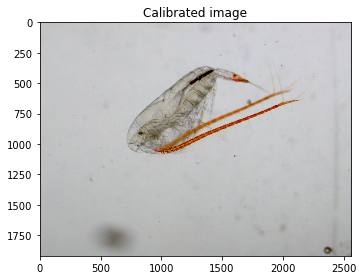

-0.10603895546833436

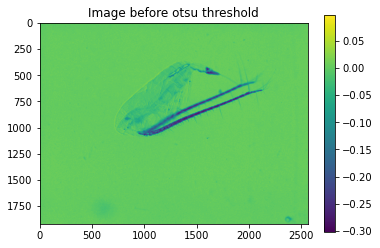

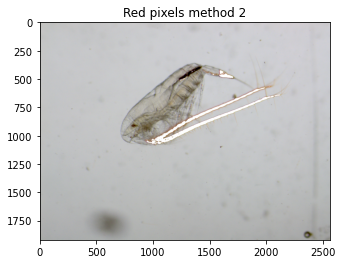

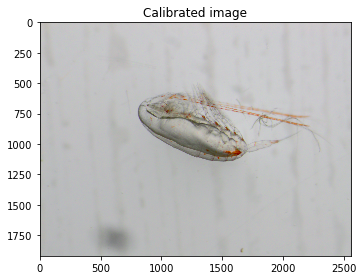

-0.04525190093307398

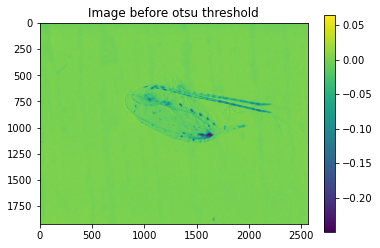

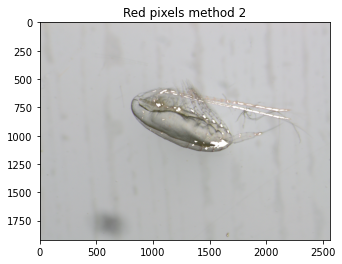

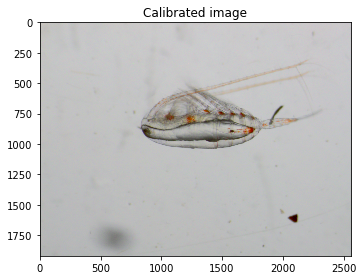

-0.0364888158939327

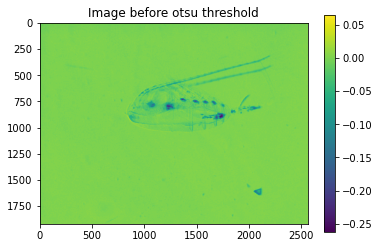

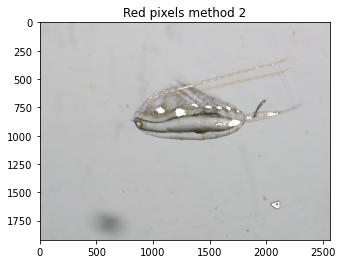

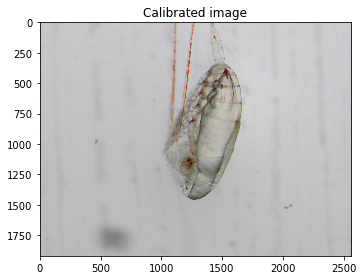

-0.03501936665466192

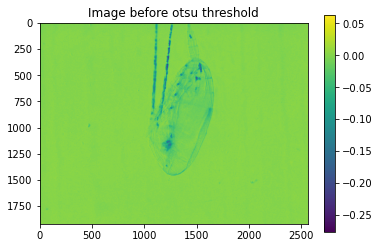

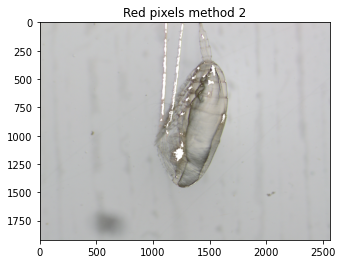

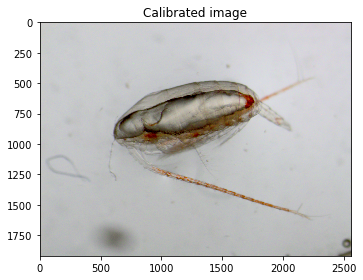

-0.03816235665572816

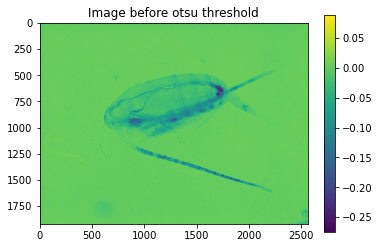

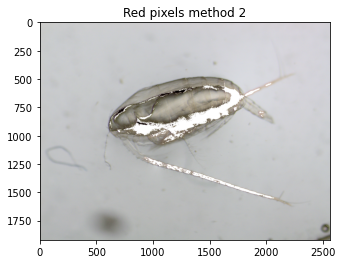

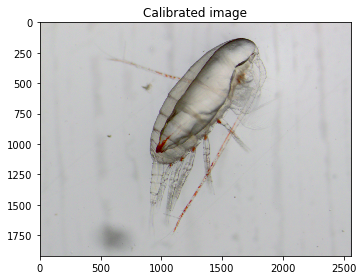

-0.019298411025342285

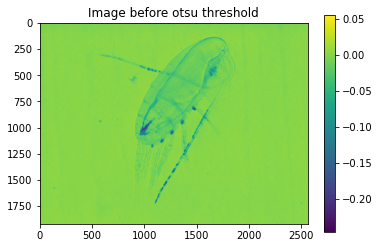

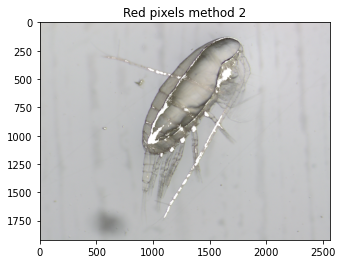

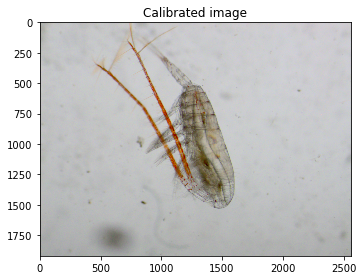

-0.07646252949614739

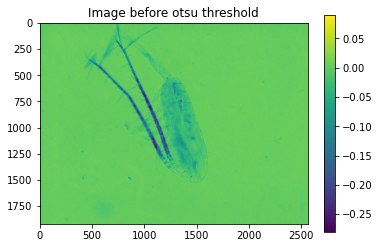

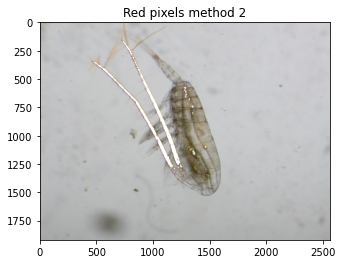

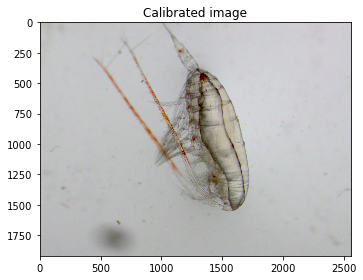

-0.02632091317062199

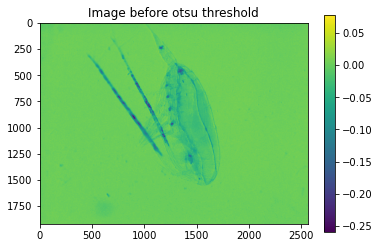

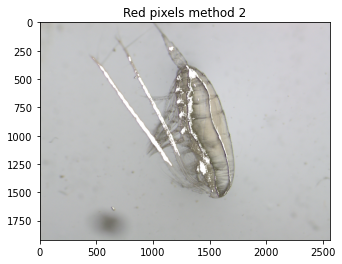

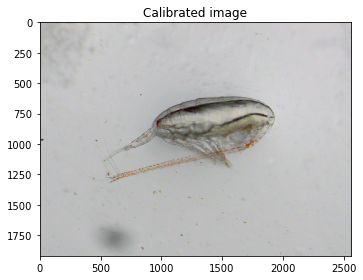

-0.023330614201231864

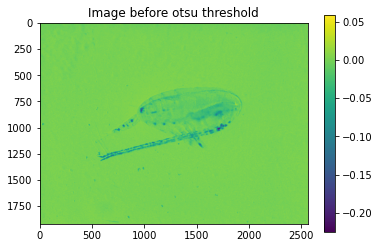

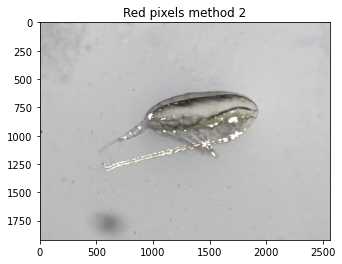

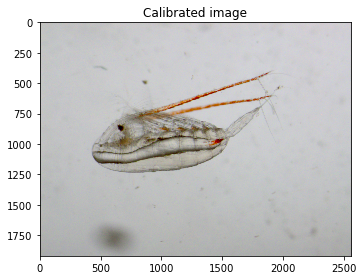

-0.07226524680163089

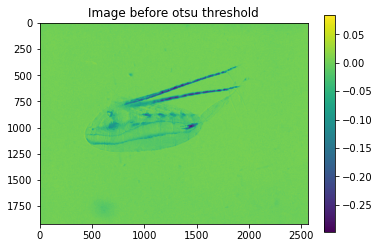

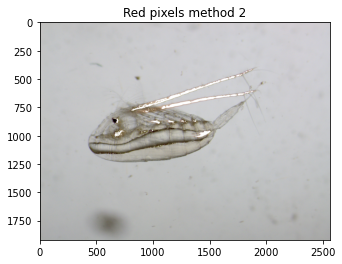

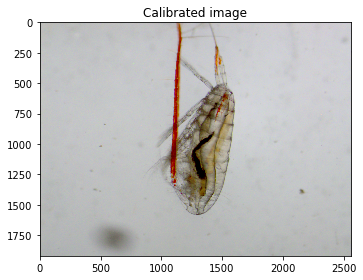

-0.08440254859643827

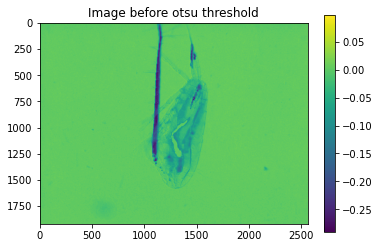

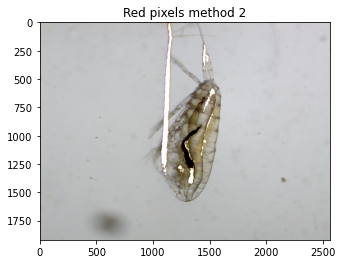

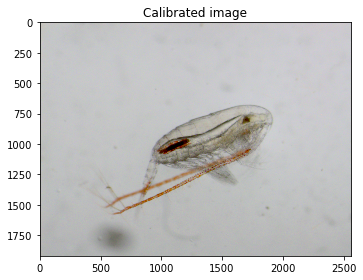

-0.04569724912215477

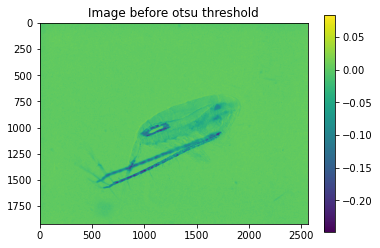

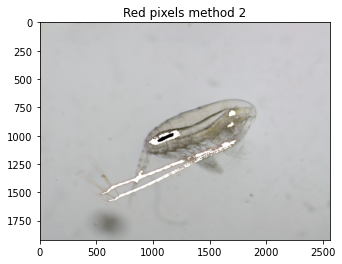

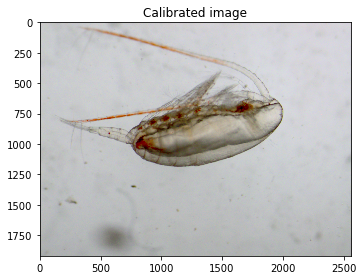

-0.03807154161220304

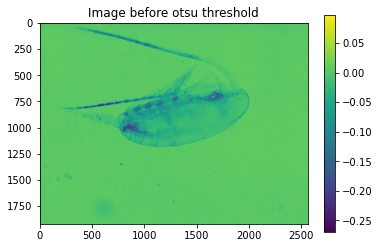

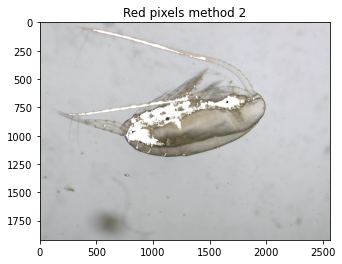

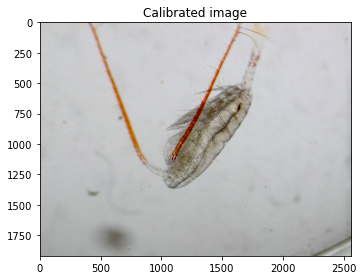

-0.08589954482725848

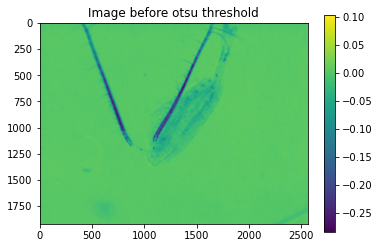

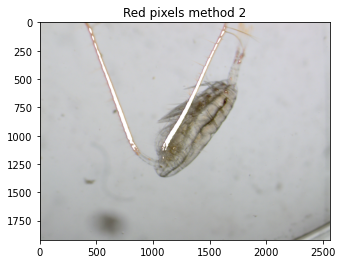

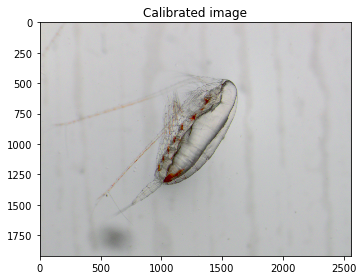

-0.05736673133197279

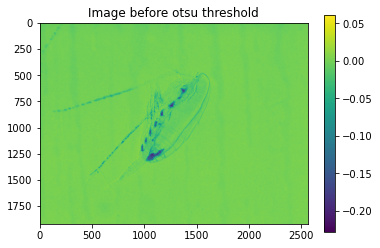

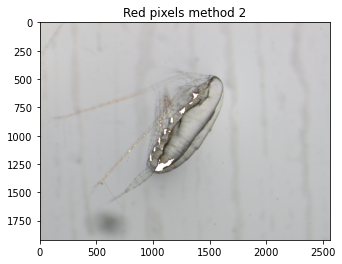

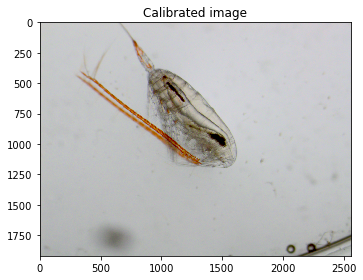

-0.07459518586666966

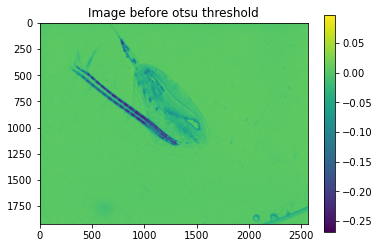

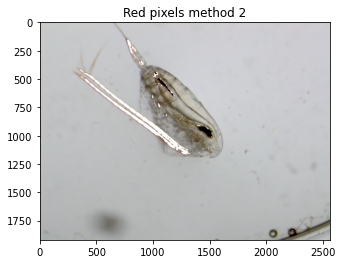

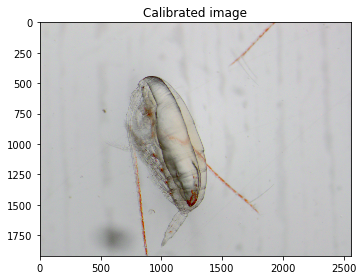

-0.03993263161258431

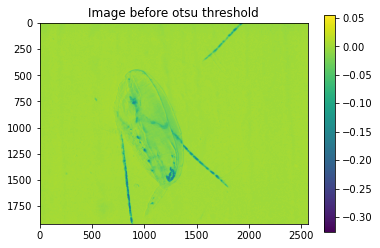

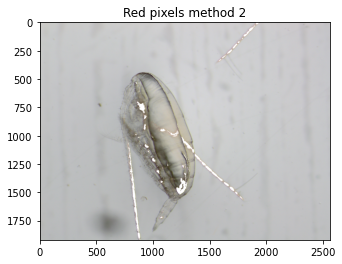

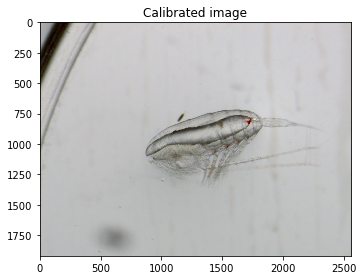

-0.005787275650455337

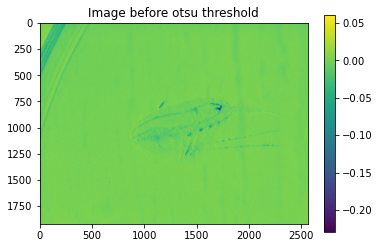

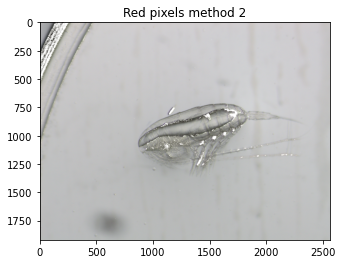

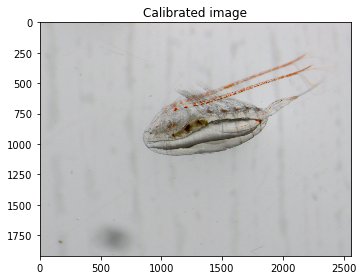

-0.047005182273616594

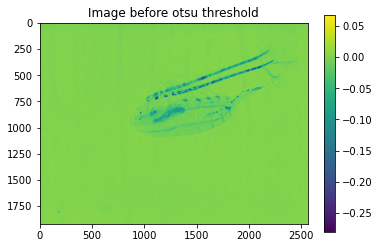

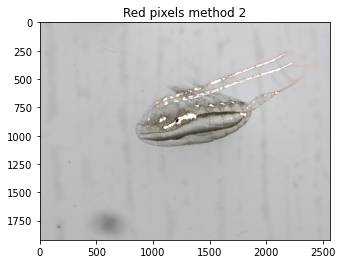

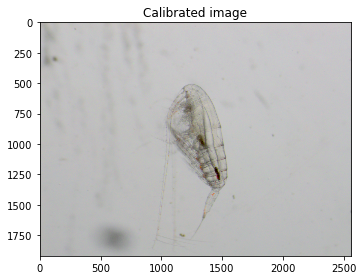

-0.004877444793651167

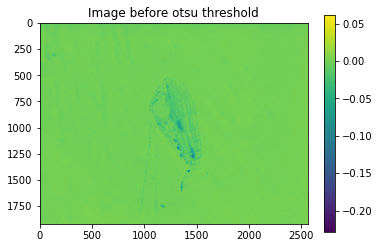

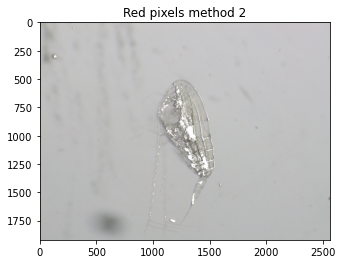

In [110]:
## 3.1. Identify red pigments (method 2 - color deconvolution) 

# Optical Density (OD) matrix : 
rgb_from_stains = np.array([
    [0.51, 0.11, 0.06],
    # Background
    [0.65, 0.65, 0.65],
    # Placeholder
    [0,0,0]])

# Calculate residuals = normalize the OD matrix: 
rgb_from_stains[2, :] = np.cross(rgb_from_stains[0, :], rgb_from_stains[1, :])
display("normalized OD matrix :", rgb_from_stains)

# Calculate matrix inverse with linalg.inv :
stains_from_rgb = linalg.inv(rgb_from_stains)
display("inversed OD matrix = color deconvolution matrix:", stains_from_rgb)


for i in range(len(ims_calib)) :
    
    # Show image
    if i in range(0,20) :
        plt.title("Calibrated image")
        io.imshow(ims_calib[i][1])
        plt.show()
    
    # Extract stains 
    # RGB to stain color space conversion (sickit image)
    stains = separate_stains(ims_calib[i][1], stains_from_rgb)
    red = stains[...,0]
    # threshold using intensities histogramm on the image 
    thr = threshold_otsu(red, nbins=50)
    display(thr)

    # red mask :
    red_mask = red < (thr-0.015)
    
    # Show on original image
    im_highlight = copy.copy(ims_calib[i][1])
    im_highlight[:,:,0][red_mask] = 255
    im_highlight[:,:,1][red_mask] = 255
    im_highlight[:,:,2][red_mask] = 255
    

    plt.title("Image before otsu threshold")
    low, high = np.quantile(red, (1, .0))
    plt.imshow(red, vmin=high, vmax = low)
    plt.colorbar()
    plt.show()
    plt.title("Red pixels method 2")
    plt.imshow(im_highlight)
    plt.show()
    io.imsave("image_data/processed_images/second_try/" + ims_calib[i][0] + "_redpixels_RGBdeconvmethod.jpg", im_highlight)


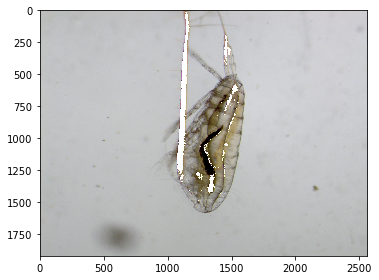

In [17]:
# Test
io.imshow("image_data/processed_images/second_try/B_A1_10.tif_calibrated.jpg")
io.imshow("image_data/processed_images/second_try/B_A1_10.tif_segmented.jpg")
io.imshow("image_data/processed_images/second_try/B_A1_10.tif_redpixels_LHCmethod.jpg")
io.imshow("image_data/processed_images/second_try/B_A1_10.tif_redpixels_RGBdeconvmethod.jpg")